# Prosjekt 1
#### Gruppe 49: Eirik Jacceri Høydalsvik, Martin Johnsrud, Hans Gløckner Giil

## Innledning

Formålet med denne oppgaven er å løse en versjon av det velkjente cocktailparty-problemet, hvor mange samtidige lyder i et rom gjør det vanskelig å høre hva som blir sagt. Gitt $n$ "lydopptak" med mikset lyd fra de ulike lydkilder, skal programmet separere de miksede signalene og returnere de opprinnelige lydsignalene.

Den matematiske metoden som det tas utgangspunkt i er uavhengig komponentanalyse. Det antas at kildene er statistisk uavhengige av hverandre, og at lydsignalene ikke er gaussiskt fordelt. Det antas også at n = d, altså at det er like mange lydopptak som lydkilder. Dette forenkler problemet. Sentralgrenseteoremet gir da at en kombinasjon av signalene vil bli mer normalfordelt(gaussisk) enn hvert av signalene, slik at man kan separere signalene ved å finne miksematrisen som gjør de separerte signalene minst gaussiske. I denne oppgaven bruker vi målene kurtose og negentropi som to forskjellige mål på "ikke-gaussiskhet".

Problemet angripes ved å la $s_j(t)$ betegne lydsignal $j$, og la 

$$x_j = a_{i1} s_{1} + a_{i2} s_2 + ... + a_{id}  s_d, \; i = 0,1, ...,d $$ 

være mikset lydsignal nummer $j$. Problemet kan altså betraktes slik; en ukjent miksematrise $\mathbf{A}$ transformerer en matrise $\mathbf{S}$ som inneholder lydsignalene $s$ som radvektorer til en matrise $\mathbf{X}$ som har de miksede signalene $x$ som radvektorer. Oppgaven blir da å finne inversmatrisen til $\mathbf{A}$, $\mathbf{A^{-1}}$, slik at S kan bestemmes ved 

$$ \mathbf{S} = \mathbf{A^{-1}} \mathbf{X}$$. 

I oppgaven bruker $y_j(t)$ som en tilnærming til $s_j(t)$, og matrisen $\mathbf{W}$ som en tilnærming til $\mathbf{A^{-1}}$.

I tillegg til å separere de tre gitte lydfilene har vi lagt inn 7 egne lydfiler fra nettet. Om programmet skal bruke de gitte lydfilene eller våre egne lydfiler kan velges under "Parametere".  Det kan også velges hvor mange lydsignaler som programmet skal kjøre, og om det skal bruke negentropi eller kurtose kan også velges her. Hvordan parameterne skal brukes er forklart i kommentarene i koden. I tillegg har vi plottet lydsignalene, slik at det er mulig å se at programmet minimerer gaussiskhet grafisk.


## Parametere

Her er parameterene som bestemmer hva koden gjør

In [1]:
# Om det skal ingkulderes egne lydfiler, eller burke eksempelfilene
egneLydfiler = True

# Antall signaler som skal importeres
numSignals = 5

if not egneLydfiler:
    numSignals = 3

# Toleranse for å slutte loopen
tol = 1e-12

# Iterasjoner før loop sluttes, loopen slutter hvis antall iterasjoner > maxIter eller deltaW < tol
maxIter = 100

# Skriver ut en av lydfilen hver nte iterasjon, for å kunne skje progresjonen, n=pritFreq. 
# printFreq = 0 for ikke å printe i loopen
printFreq = 0

# Velger om det skal brukes negentropi eller kurtose. Parameterene er "negentropi" og "kurtose"
chooseG = "kurtose"

# Funksjon som regner ut kurtosen
def kurtose(u):
    return 4 * u **3

# Derivert av kurtose funksjon
def DKurtose (u):
    return 12 * u **2

# Regner ut negentropi
def negentropi(x):
    return x * np.exp(-x**2/2)

# Deriverte av negentropi
def DNegentropi(x):
    return (1 - x**2) * np.exp(-1/2*x**2)

## Forberedelser
Først må vi importere data. Vi antar i koden nedenfor at lydfilene med miksede signaler ligger på audio/mix_1.wav,
audio/mix_2.wav, audio/mix_3.wav. Du skal i arkivet Prosjekt1.zip kunne finne disse filene samt wav_file_loader.py som blir importert i koden nedenfor.

In [2]:
# I denne cella laster vi opp tre miksede lydklipp som vi skal bruke å teste ut algoritmen på
import numpy as np
from wav_file_loader import read_wavefiles
import IPython.display as ipd

# Spiller av alle lydklippene gitt en matrise
def playAudio(files):
    for file in files:
        ipd.display(ipd.Audio(file, rate=sampleRate))

# I denne cellen fins en funksjon som normaliserer lydsignalenes volum, slik at de får omtrent samme lydstyrke
def normalizeAudio(data):
    # Scale amplitude s.t. max(data[i]) == 1.
    absData = np.absolute(data)
    maximums = np.amax(absData,1)

    # Divide each row by a different vector element:
    data = data / maximums.reshape((numSignals,1))
    return data

def getData(numSignals, egneLydfiler):
    if egneLydfiler:
        filename = "audio/heimemekk_"
    else:
        filename = "audio/mix_"

    paths = [filename + str(i) + ".wav" for i in range(1, numSignals + 1)]
    print(paths)
    data, sampleRate = read_wavefiles(paths)
    
    return normalizeAudio(data), sampleRate

In [3]:
# egneLydfiler=True gjør at våre egne lydfilere hentes istendefor eksempelfilene
data, sampleRate = getData(numSignals, egneLydfiler)
data= normalizeAudio(data)
playAudio(data)

['audio/heimemekk_1.wav', 'audio/heimemekk_2.wav', 'audio/heimemekk_3.wav', 'audio/heimemekk_4.wav', 'audio/heimemekk_5.wav']


## Miksing

Denne delen om miksing, inkludert kodecellen nedenfor kan du foreløpig ignorere. Men dersom du seinere vil teste ut algoritmen ved å selv blande opplastede uavhengige signaler så kan funksjonene nedenfor komme til nytte.

In [4]:
# Divide each row in A by its sum.    
# The sum of each row in the result is 1.0.
def normalizeRowsums(A):
    
    theSum = np.sum(A,1)
    A = A / theSum.reshape((numSignals, 1))
    return A


# Creates a random matrix
# Each element is a small positive number, not too close to 0.
# (1/11, 5/7).
def randomMixingMatrix(signals, observations):
    
    A = 0.25 + np.random.rand(observations, signals)
    return normalizeRowsums(A)


In [5]:
A = randomMixingMatrix(numSignals, numSignals)
dataMixed = normalizeAudio(A @ data)
playAudio(dataMixed)

## Preprosessering

I den etterfølgende cellen skal du skrive funksjonene <font color='blue'> centerRows </font> og <font color='blue'> whitenRows </font> for å gjøre de preprosesseringsstegene som er omtalt i prosjektbeskrivelsen. I hvert tilfelle er variabelen Z et array av dimensjon $d\times N$ av miksede signaler.

In [6]:
# Tar inn en matrise Z. For vert element i radene i Z trekkes gjennomsnittet av raden i fra. Returnerer modifisert matrise. 
def centerRows(Z):
    for row in Z:
        row -= np.mean(row)
    return Z

# Tar inn matrise Z og returnerer ukorrelert Z: Zwr og invers roten av covarians matrisen til Z: T.
def whitenRows(Z):
    C = np.cov(Z)
    U, S, _ = np.linalg.svd(C, full_matrices=False)
    T  = U @ np.diag(1 / np.sqrt(S)) @ U.T
    Zwr = T @ Z
    return Zwr,T

## Hovediterasjonen - maksimering av ikke-gaussiskhet

In [7]:
#Tar inn en matrise Z og returnerer Z med normaliserte rader.
def normalizeRows(Z):
    for i in range(len(Z)):
        Z[i] = Z[i] / np.sqrt(np.dot(Z[i], Z[i]))
    return Z

In [8]:
#Funksjon som regner ut kvadratroten av en matrise A
def inverseSqrt(A):
    U, S, _ = np.linalg.svd(A, full_matrices=False)
    return U @ np.diag(1 / np.sqrt(S)) @ U.T

#Tar in en dxd matrise W og returnerer en ortogonalisert versjon av W
def decorrelateWeights(W):
    return inverseSqrt(W @ W.T) @ W

In [9]:
# Tar inn en ortonormal dxd matrise W og en dxn matrise Zcw. Returner en ny ortonormalisert dxd matrise WPlussOne, 
# slik at WPlussOne @ Zcw er mindre gaussisk enn W @ Zcw.
def updateW(W, Zcw, d, Gfunc, DGfunc):
    
    N = Zcw[0].size
    S = W @ Zcw  
    G = Gfunc(S)
    Gderivative = DGfunc(S)
    averageOfRowsInGDerivative = np.average(Gderivative, axis=1)
    
    diagonalMatrix = np.diag(averageOfRowsInGDerivative)  #Lager diagonal matrise med averageOfRows.. på diagonalen, resten 0.
   
    WPlus = 1 / N * G @ np.transpose(Zcw) -  diagonalMatrix @ W
    
    WPlus = normalizeRows(WPlus)
    
    WPlusOne = decorrelateWeights(WPlus)

    return WPlusOne 

In [10]:
# Tar inn W1 og W2, hvor W2 = updateW(W1). Returnerer max, et mål på hvor forskjellige matrisene er.
def measureOfConvergence(W1, W2):
    max = -10000008
    for i in range(len(W1)):
        innerProduct = np.absolute(np.dot(W1[i],W2[i].T))
        if (1 - innerProduct) > max:
            max = 1 - innerProduct       
    return max

In [11]:
import warnings
# Tar inn mikset matrise Z, antall signaler d, variblen choosG som bestemmer funksjon G som skal måle gausiskhet og dens deriverte DG, 
# toleransen for endringen mellom itterasjonene tol og max anntal iterasjoner maxIter. Opdaterer W med updateW helt til differansen
# er mindre en tol. Returnerer de separerte signalene W @ Z, miksematrisen Wk antall iterasjoner, den endelige differansen og om maxIter
# ble nådd, eller om loopen ble sluttet på grunn av at i nådde maxIter

def fastICA(Z, d, printFreq, tol, maxIter, chooseG):
    Z = centerRows(Z)
    Z, T = whitenRows(Z)
    deltaW = 1e12
    i = 0
    Wk = normalizeRows(np.random.rand(d, d))
    
    if chooseG == "negentropi":
        Gfunc = negentropi
        DGfunc = DNegentropi
        
    elif chooseG == "kurtose":
        Gfunc = kurtose
        DGfunc = DKurtose
        
    else: 
        raise Exception("Feil i 'chooseG'")
    
    while((deltaW > tol) and (i < maxIter)):
        
        # Print ut resultatet for den første lydfilen hver (pritFreq)-te iterasjon
        if printFreq:
            if i % printFreq == 0:
                print("Iterasjon nummer: ", i)
                print(deltaW)
                playAudio([(Wk @ Z)[0]])

        Wkplus1 = updateW(Wk, Z, d, Gfunc, DGfunc)
        deltaW = measureOfConvergence(Wk, Wkplus1)
        Wk = Wkplus1
        i += 1

    return Wk @ Z, Wk, i, deltaW, i >= maxIter

In [12]:
S, W, i, deltaW, MaxIterReached = fastICA(dataMixed, numSignals, printFreq, tol, maxIter, chooseG)

print("Loop sluttet fordi i >= maxIter: ", MaxIterReached)
print("deltaW = ", deltaW)
print("Iterasjoner: ", i)

playAudio(S)

Loop sluttet fordi i >= maxIter:  False
deltaW =  2.5091040356528538e-14
Iterasjoner:  10


## Plotting

Vær av lydfilene blir plottet som histogrammer. Gitt en vektor $\vec{a} = [a_1, a_2, ... a_k]$ med samples. Intervallet $[\min(a_i), \max(a_i)]$ deles opp i $n$ delintervaller $\{I_j\}_{j=1}^n$, og amplituden, normert, plottes mot antallet samples $a_i \in I_j$.A De oransje plottenen til høyre er filene etter de har blitt blannet av blandingsmatrisen $A$, mens de blå plottene er de separerte lydfilene.

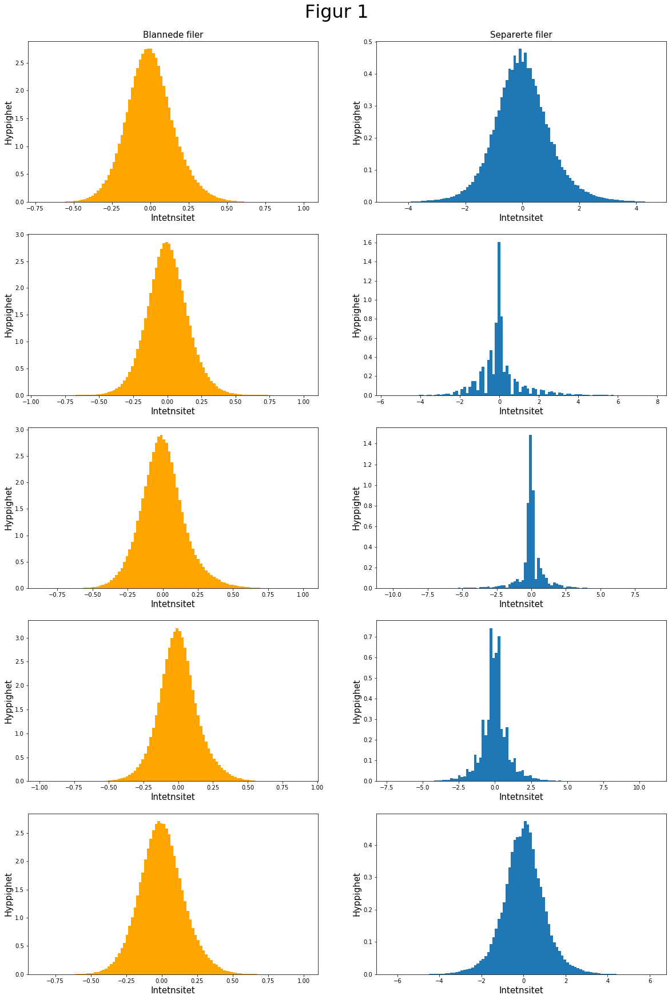

In [15]:
import matplotlib.pyplot as plt

fig, ax = plt.subplots(numSignals,2, figsize=(20, 30))
fig.suptitle("Figur 1", fontsize=32, x=0.5, y=0.91)
ax[0][0].set_title("Blannede filer", size=15)
ax[0][1].set_title("Separerte filer", size=15)
for i in range(len(ax)):
    for j in range(len(ax[i])):
        if j % 2 == 1:
            ax[i][j].hist(S[i], 100, density=True)
            
        else:
            ax[i][j].hist(dataMixed[i], 100, color = "orange", density=True)
        
        ax[i][j].set_xlabel("Intetnsitet", size=15)
        ax[i][j].set_ylabel("Hyppighet", size=15)
            
plt.savefig("plot.png")

## Konklusjon

Etter å ha kjørt programmet med ulike lydfiler, både de tre som var gitt i oppgaven og lydfiler funnet på nettet, klarte programmet å separere lydfilene i de fleste tilfellene. Dersom vi økte antallet  lydfiler til mer enn $5$ fungerte ikke separasjonen. Programmet klarte da ikke alltid å skille lydfiler som inneholder tale fra lydfiler med musikk, og det ble returnert et eller flere par med musikk og tale som ikke ble separert. De resterende lydfilene ble separert. Ulike valg av $W_0$ har ikke gitt utslag på hvor godt filene ble separert, men det påvirker hvor fort konvergensen skjer. 

For å teste hastigheten på programmet kjørte vi $1000$ tester på de tre utdelte lydfilene. Med kurtose som mål på gaussiskhet ble lydfilene i snitt separert på $11$ iterasjoner og $0.25 \, \textrm{s}$ med en toleranse på $10^{-12}$. Med negentropi brukte programmet i snitt $9$ iterasjoner og $0.23$ sekunder. Denne tester antyder dermed at negentropi er en mer effektivt mål på ikke-gaussiskhet i dette tilfellet. 

Det er tydelig forskjell på plottene av de blandede og separerte lydfilene. Kvalitativt har histogrammene av intensiteten av de blandede filene en mer gaussisk form enn de separerte filene. Det er også mulig å skille mellom musikk og tale. Lydfilene med musikk har brede histogrammer, som plottet nederst til høyre på Figur 1, i motsetning til de spisse histogrammene fra tale, som øverst til høyre på Figur 1.

<img src="image/plotTilRapport.png" width="1000" height="10000" align="middle">